In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import calendar
from pandas.api.types import CategoricalDtype
from sklearn.preprocessing import StandardScaler

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"amankumar0323","key":"0d864b07076e323aaef37371e0105a10"}'}

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/kaggle.json
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:

!kaggle datasets download -d bhavyadhingra00020/india-rental-house-price

Dataset URL: https://www.kaggle.com/datasets/bhavyadhingra00020/india-rental-house-price
License(s): apache-2.0
  0% 0.00/849k [00:00<?, ?B/s]
100% 849k/849k [00:00<00:00, 1.35GB/s]


In [ ]:
# Replace 'dataset-name.zip' with the actual name of the downloaded zip file
!unzip -o india-rental-house-price.zip

Archive:  india-rental-house-price.zip
  inflating: Indian_housing_Delhi_data.csv  
  inflating: Indian_housing_Mumbai_data.csv  
  inflating: Indian_housing_Pune_data.csv  


In [ ]:
!ls

drive				Indian_housing_Pune_data.csv  sample_data
Indian_housing_Delhi_data.csv	india-rental-house-price.zip
Indian_housing_Mumbai_data.csv	kaggle.json


In [ ]:

pd.set_option('display.max_columns',None) #to display all columns
pd.set_option('display.max_rows',None) #to display all rows

In [ ]:
df_train = pd.read_csv('Indian_housing_Delhi_data.csv')
df_train.head()

,house_type,house_size,location,city,latitude,longitude,price,currency,numBathrooms,numBalconies,isNegotiable,priceSqFt,verificationDate,description,SecurityDeposit,Status
0,1 RK Studio Apartment,400 sq ft,Kalkaji,Delhi,28.545561,77.254349,22000,INR,1.0,NaN,NaN,NaN,Posted a day ago,"Fully furnished, loaded with amenities & gadge...",No Deposit,Furnished
1,1 RK Studio Apartment,400 sq ft,Mansarover Garden,Delhi,28.643259,77.132828,20000,INR,1.0,NaN,NaN,NaN,Posted 9 days ago,Here is an excellent 1 BHK Independent Floor a...,No Deposit,Furnished
2,2 BHK Independent Floor,500 sq ft,Uttam Nagar,Delhi,28.618677,77.053352,8500,INR,1.0,NaN,NaN,NaN,Posted 12 days ago,"Zero Brokerage.\n\n2 Room set, Govt bijali Met...",No Deposit,Semi-Furnished
3,3 BHK Independent House,"1,020 sq ft",Model Town,Delhi,28.712898,77.180000,48000,INR,3.0,NaN,NaN,NaN,Posted a year ago,Itâs a 3 bhk independent house situated in M...,No Deposit,Furnished
4,2 BHK Apartment,810 sq ft,Sector 13 Rohini,Delhi,28.723539,77.131424,20000,INR,2.0,NaN,NaN,NaN,Posted a year ago,Well designed 2 bhk multistorey apartment is a...,No Deposit,Unfurnished


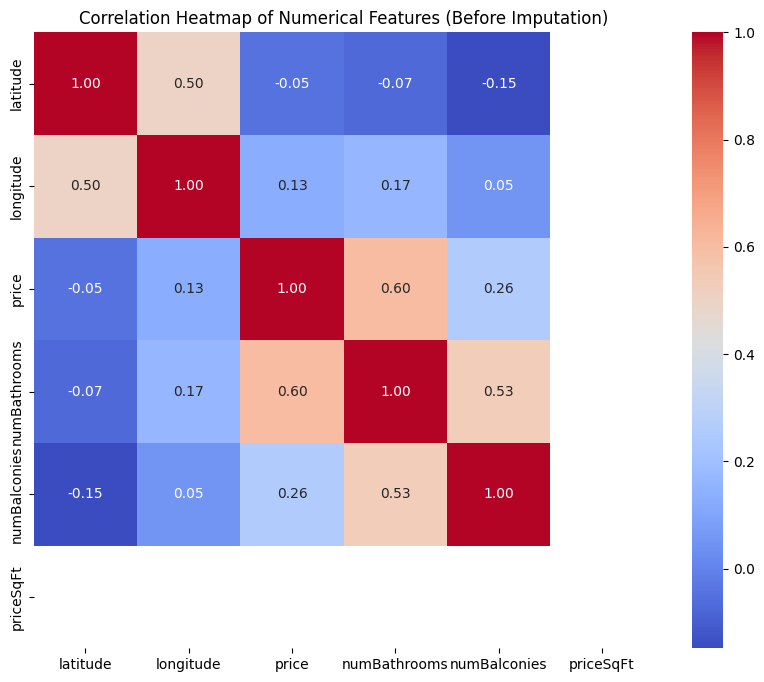

In [ ]:
import pandas as pd
df_train = pd.read_csv('Indian_housing_Delhi_data.csv')
df_test = pd.read_csv('Indian_housing_Delhi_data.csv')
df=pd.concat((df_train,df_test))
df = df.reset_index(drop=True)

numerical_features = df.select_dtypes(include=['int64', 'float64']).columns
correlation_matrix = df[numerical_features].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap of Numerical Features (Before Imputation)')
plt.show()

In [ ]:
df_test = pd.read_csv('Indian_housing_Delhi_data.csv')
df_test.head()

,house_type,house_size,location,city,latitude,longitude,price,currency,numBathrooms,numBalconies,isNegotiable,priceSqFt,verificationDate,description,SecurityDeposit,Status
0,1 RK Studio Apartment,400 sq ft,Kalkaji,Delhi,28.545561,77.254349,22000,INR,1.0,NaN,NaN,NaN,Posted a day ago,"Fully furnished, loaded with amenities & gadge...",No Deposit,Furnished
1,1 RK Studio Apartment,400 sq ft,Mansarover Garden,Delhi,28.643259,77.132828,20000,INR,1.0,NaN,NaN,NaN,Posted 9 days ago,Here is an excellent 1 BHK Independent Floor a...,No Deposit,Furnished
2,2 BHK Independent Floor,500 sq ft,Uttam Nagar,Delhi,28.618677,77.053352,8500,INR,1.0,NaN,NaN,NaN,Posted 12 days ago,"Zero Brokerage.\n\n2 Room set, Govt bijali Met...",No Deposit,Semi-Furnished
3,3 BHK Independent House,"1,020 sq ft",Model Town,Delhi,28.712898,77.180000,48000,INR,3.0,NaN,NaN,NaN,Posted a year ago,Itâs a 3 bhk independent house situated in M...,No Deposit,Furnished
4,2 BHK Apartment,810 sq ft,Sector 13 Rohini,Delhi,28.723539,77.131424,20000,INR,2.0,NaN,NaN,NaN,Posted a year ago,Well designed 2 bhk multistorey apartment is a...,No Deposit,Unfurnished


Data Integration


In [ ]:
df=pd.concat((df_train,df_test))
df = df.reset_index(drop=True)
temp_df=df
print(df.shape)

(10000, 16)


In [ ]:
# Create the 'id' column with IDs starting from 1 (1 to n)
id_column = range(1, len(df) + 1)

# Use .insert() to place 'id' at the first position (index 0)
df.insert(0, 'id', id_column)

# Optional: Display the first few rows to verify the new column
df.head()

,id,house_type,house_size,location,city,latitude,longitude,price,currency,numBathrooms,numBalconies,isNegotiable,priceSqFt,verificationDate,description,SecurityDeposit,Status
0,1,1 RK Studio Apartment,400 sq ft,Kalkaji,Delhi,28.545561,77.254349,22000,INR,1.0,NaN,NaN,NaN,Posted a day ago,"Fully furnished, loaded with amenities & gadge...",No Deposit,Furnished
1,2,1 RK Studio Apartment,400 sq ft,Mansarover Garden,Delhi,28.643259,77.132828,20000,INR,1.0,NaN,NaN,NaN,Posted 9 days ago,Here is an excellent 1 BHK Independent Floor a...,No Deposit,Furnished
2,3,2 BHK Independent Floor,500 sq ft,Uttam Nagar,Delhi,28.618677,77.053352,8500,INR,1.0,NaN,NaN,NaN,Posted 12 days ago,"Zero Brokerage.\n\n2 Room set, Govt bijali Met...",No Deposit,Semi-Furnished
3,4,3 BHK Independent House,"1,020 sq ft",Model Town,Delhi,28.712898,77.180000,48000,INR,3.0,NaN,NaN,NaN,Posted a year ago,Itâs a 3 bhk independent house situated in M...,No Deposit,Furnished
4,5,2 BHK Apartment,810 sq ft,Sector 13 Rohini,Delhi,28.723539,77.131424,20000,INR,2.0,NaN,NaN,NaN,Posted a year ago,Well designed 2 bhk multistorey apartment is a...,No Deposit,Unfurnished


In [ ]:
df.head()


,id,house_type,house_size,location,city,latitude,longitude,price,currency,numBathrooms,numBalconies,isNegotiable,priceSqFt,verificationDate,description,SecurityDeposit,Status
0,1,1 RK Studio Apartment,400 sq ft,Kalkaji,Delhi,28.545561,77.254349,22000,INR,1.0,NaN,NaN,NaN,Posted a day ago,"Fully furnished, loaded with amenities & gadge...",No Deposit,Furnished
1,2,1 RK Studio Apartment,400 sq ft,Mansarover Garden,Delhi,28.643259,77.132828,20000,INR,1.0,NaN,NaN,NaN,Posted 9 days ago,Here is an excellent 1 BHK Independent Floor a...,No Deposit,Furnished
2,3,2 BHK Independent Floor,500 sq ft,Uttam Nagar,Delhi,28.618677,77.053352,8500,INR,1.0,NaN,NaN,NaN,Posted 12 days ago,"Zero Brokerage.\n\n2 Room set, Govt bijali Met...",No Deposit,Semi-Furnished
3,4,3 BHK Independent House,"1,020 sq ft",Model Town,Delhi,28.712898,77.180000,48000,INR,3.0,NaN,NaN,NaN,Posted a year ago,Itâs a 3 bhk independent house situated in M...,No Deposit,Furnished
4,5,2 BHK Apartment,810 sq ft,Sector 13 Rohini,Delhi,28.723539,77.131424,20000,INR,2.0,NaN,NaN,NaN,Posted a year ago,Well designed 2 bhk multistorey apartment is a...,No Deposit,Unfurnished


In [ ]:
df.tail()


,id,house_type,house_size,location,city,latitude,longitude,price,currency,numBathrooms,numBalconies,isNegotiable,priceSqFt,verificationDate,description,SecurityDeposit,Status
9995,9996,4 BHK Villa,"5,896 sq ft",Sunder Nagar,Delhi,28.618437,76.961784,1022001,INR,4.0,2.0,NaN,NaN,Posted 2 months ago,Its four bhk villa in the super location of De...,"40,10,102",Unfurnished
9996,9997,5 BHK Independent House,"6,521 sq ft",Sunder Nagar,Delhi,28.618437,76.961784,1549181,INR,4.0,2.0,NaN,NaN,Posted 2 months ago,A 5 bhk property is available for rent in Sund...,"54,01,015",Unfurnished
9997,9998,3 BHK Independent Floor,"1,855 sq ft",New Friends Colony,Delhi,28.567051,77.273560,301012,INR,3.0,2.0,NaN,NaN,Posted 2 months ago,Its three bhk builder floor in the super locat...,"18,18,181",Unfurnished
9998,9999,3 BHK Independent Floor,"2,856 sq ft",New Friends Colony,Delhi,28.567051,77.273560,301011,INR,3.0,2.0,NaN,NaN,Posted 2 months ago,Its three bhk builder floor in the super locat...,"10,10,110",Unfurnished
9999,10000,3 BHK Independent Floor,"2,856 sq ft",New Friends Colony,Delhi,28.567051,77.273560,301012,INR,4.0,2.0,NaN,NaN,Posted 2 months ago,Its three bhk builder floor in the super locat...,"10,10,182",Unfurnished


In [ ]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                10000 non-null  int64  
 1   house_type        10000 non-null  object 
 2   house_size        10000 non-null  object 
 3   location          10000 non-null  object 
 4   city              10000 non-null  object 
 5   latitude          10000 non-null  float64
 6   longitude         10000 non-null  float64
 7   price             10000 non-null  int64  
 8   currency          10000 non-null  object 
 9   numBathrooms      9950 non-null   float64
 10  numBalconies      5474 non-null   float64
 11  isNegotiable      358 non-null    object 
 12  priceSqFt         0 non-null      float64
 13  verificationDate  10000 non-null  object 
 14  description       9430 non-null   object 
 15  SecurityDeposit   10000 non-null  object 
 16  Status            10000 non-null  object 

In [ ]:
df.describe()


,id,latitude,longitude,price,numBathrooms,numBalconies,priceSqFt
count,10000.00000,10000.000000,10000.000000,1.000000e+04,9950.000000,5474.000000,0.0
mean,5000.50000,28.578012,77.174499,2.221738e+05,2.918593,1.954330,NaN
std,2886.89568,0.190176,0.115631,2.739706e+05,1.087769,0.547169,NaN
min,1.00000,20.011379,72.771332,3.000000e+03,1.000000,1.000000,NaN
25%,2500.75000,28.544489,77.138248,2.950000e+04,2.000000,2.000000,NaN
50%,5000.50000,28.569295,77.196472,1.250000e+05,3.000000,2.000000,NaN
75%,7500.25000,28.618687,77.228950,3.011020e+05,4.000000,2.000000,NaN
max,10000.00000,28.805466,80.361313,3.010101e+06,10.000000,8.000000,NaN


In [ ]:
int_feature=df.select_dtypes(include=['int64']).columns


In [ ]:
float_feature=df.select_dtypes(include=['float64']).columns


In [ ]:
cat_feature=df.select_dtypes(include=['object']).columns


Visualizing Missing Values

<Axes: >

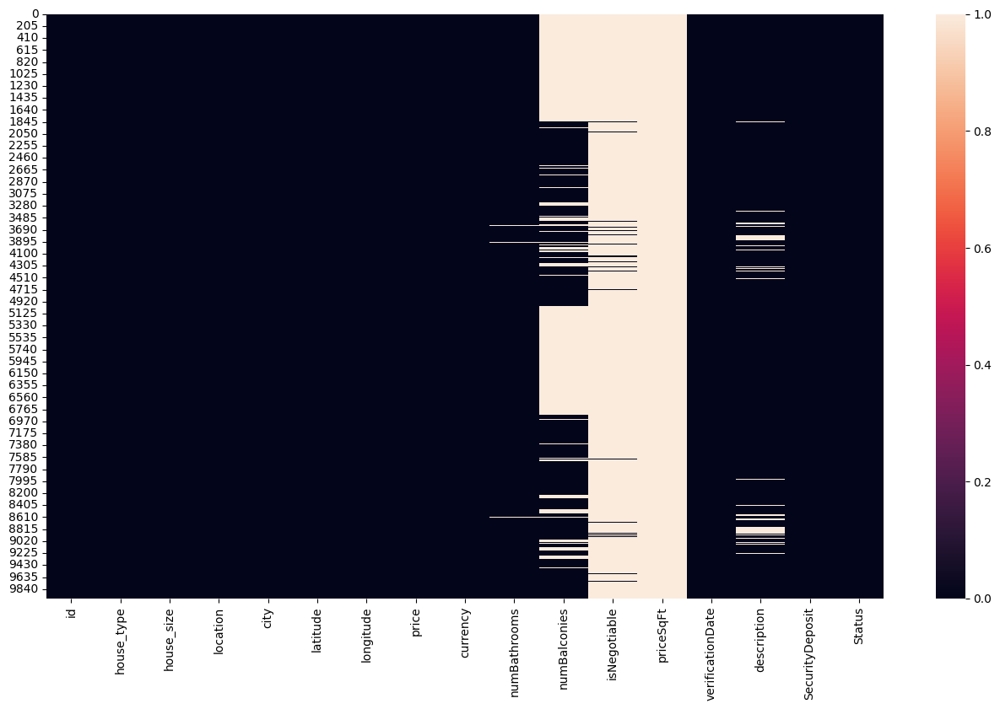

In [ ]:
plt.figure(figsize=(16,9))
sns.heatmap(df.isnull())


In [ ]:
missing_values = df.isnull().sum()
columns_with_missing_values = missing_values[missing_values > 0]

print("Columns with Missing Values:")
print(columns_with_missing_values)

Columns with Missing Values:
numBathrooms       50
numBalconies     4526
isNegotiable     9642
priceSqFt       10000
description       570
dtype: int64


In [ ]:
null_count=df.isnull().sum()
null_count

,0
id,0
house_type,0
house_size,0
location,0
city,0
latitude,0
longitude,0
price,0
currency,0
numBathrooms,50


In [ ]:
null_percent=df.isnull().sum()/df.shape[0]*100
null_percent

,0
id,0.00
house_type,0.00
house_size,0.00
location,0.00
city,0.00
latitude,0.00
longitude,0.00
price,0.00
currency,0.00
numBathrooms,0.50


In [ ]:
miss_value_50_perc=null_percent[null_percent>50]
miss_value_50_perc

,0
isNegotiable,96.42
priceSqFt,100.00


In [ ]:
miss_value_20_50_perc=null_percent[(null_percent>20)& (null_percent<51)]
miss_value_20_50_perc

,0
numBalconies,45.26


In [ ]:
miss_value_5_20_perc=null_percent[(null_percent>5)& (null_percent<21)]
miss_value_5_20_perc

,0
description,5.7


<Axes: >

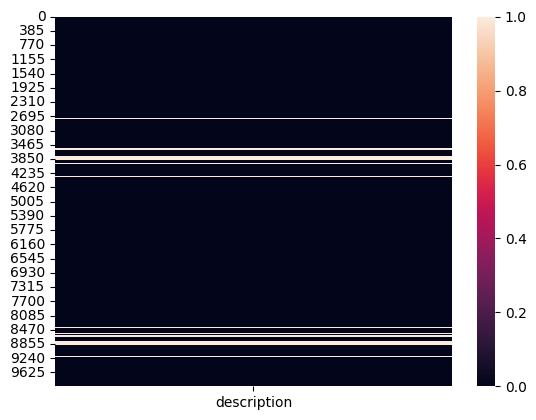

In [ ]:
sns.heatmap(df[miss_value_5_20_perc.keys()].isnull())


Missing value Imputation

In [ ]:
missing_value_feat=null_percent[null_percent>0]
print("Total missing value feature=",len(missing_value_feat))
missing_value_feat

Total missing value feature= 5


,0
numBathrooms,0.50
numBalconies,45.26
isNegotiable,96.42
priceSqFt,100.00
description,5.70


In [ ]:
print(df['city'].unique())

['Delhi']


In [ ]:
cat_na_feat=missing_value_feat[missing_value_feat.keys().isin(cat_feature)]
print("total number of categorical missing feature",len(cat_na_feat))
cat_na_feat

total number of categorical missing feature 2


,0
isNegotiable,96.42
description,5.70


In [ ]:
int_na_feat=missing_value_feat[missing_value_feat.keys().isin(int_feature)]
print("total number of int missing feature",len(int_na_feat))
int_na_feat

total number of int missing feature 0


,0


In [ ]:
float_na_feat=missing_value_feat[missing_value_feat.keys().isin(float_feature)]
print("total number of float missing feature",len(float_na_feat))
float_na_feat

total number of float missing feature 3


,0
numBathrooms,0.50
numBalconies,45.26
priceSqFt,100.00


In [ ]:
def plot_data(df, df_new, feature):
    plt.subplot(121)
    sns.countplot(x=feature, data=df)
    plt.title("Before Imputation")
    plt.subplot(122)
    sns.countplot(x=feature, data=df_new)
    plt.title("After Imputation")
    plt.show()

<Axes: xlabel='numBalconies', ylabel='count'>

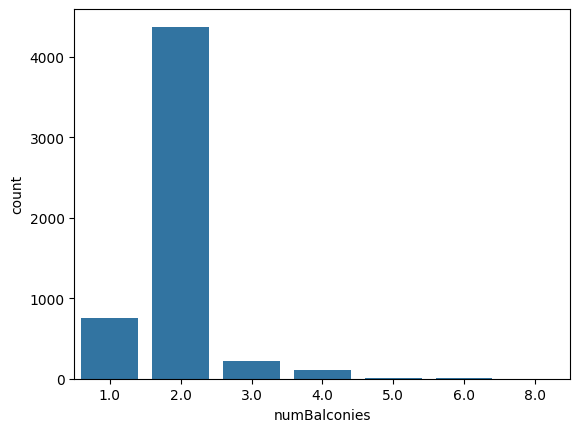

In [ ]:
df["numBalconies"].value_counts()

# count plot in graph form
sns.countplot(x=df["numBalconies"])

In [ ]:
print(df.columns)

Index(['id', 'house_type', 'house_size', 'location', 'city', 'latitude',
       'longitude', 'price', 'currency', 'numBathrooms', 'numBalconies',
       'isNegotiable', 'priceSqFt', 'verificationDate', 'description',
       'SecurityDeposit', 'Status'],
      dtype='object')


In [ ]:
df_mvi=df.copy()

In [ ]:
numBalconies_mode=df["numBalconies"].mode()[0]
numBalconies_mode
df_mvi["numBalconies"] = df_mvi["numBalconies"].replace(np.nan,numBalconies_mode)
df_mvi["numBalconies"].isnull().sum()

np.int64(0)

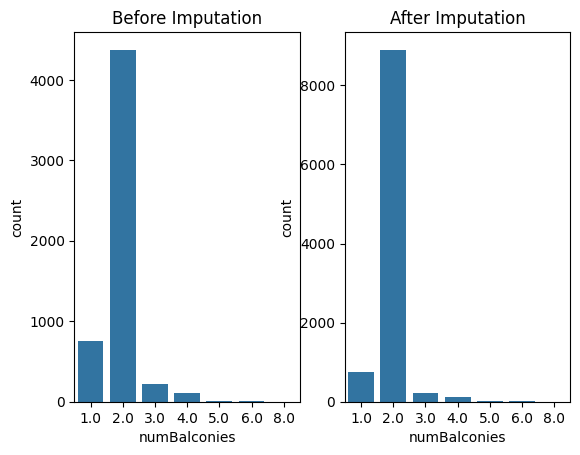

In [ ]:
feature="numBalconies"
plot_data(df,df_mvi,feature)

/tmp/ipython-input-740819490.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_mvi["priceSqFt"].replace(np.nan,alley_cont,inplace=True) # replace missing value with 'NA'


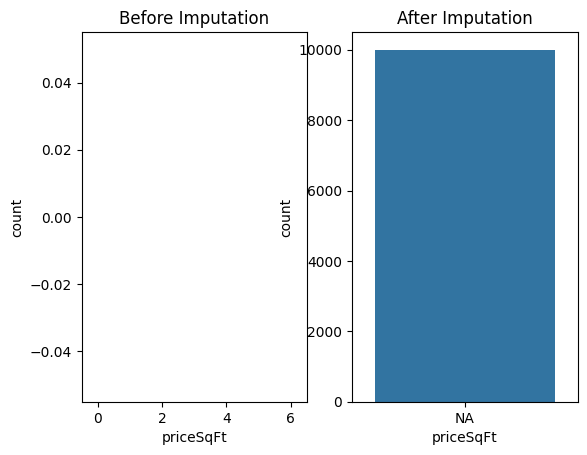

In [ ]:


df_mvi["priceSqFt"].value_counts()
alley_cont="NA"
df_mvi["priceSqFt"].replace(np.nan,alley_cont,inplace=True) # replace missing value with 'NA'
df_mvi["priceSqFt"].isnull().sum()

# compare before and after imputation
plot_data(df,df_mvi,"priceSqFt")

In [ ]:
def boxHistPlot(df,feature, figsize=(16,5)):
    plt.figure(figsize=figsize)
    plt.subplot(121)
    sns.boxplot(x=feature, data=df)
    plt.subplot(122)
    sns.histplot(x=feature,data=df,stat="density", kde=True)
    plt.show()

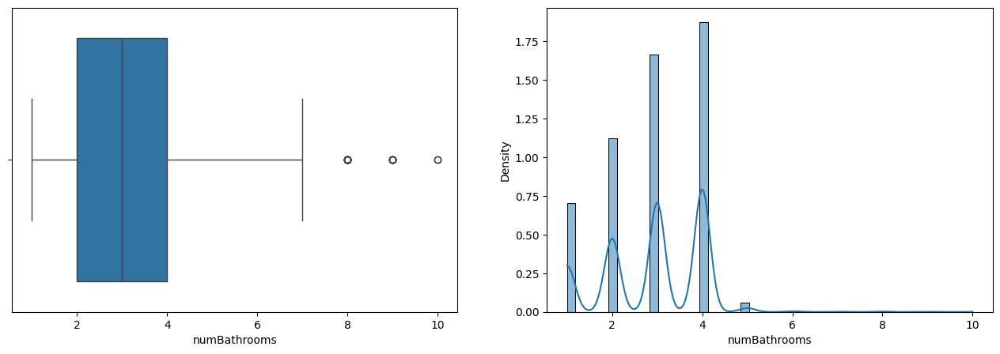

In [ ]:
boxHistPlot(df,"numBathrooms")

In [ ]:

numBathrooms_mean=df["numBathrooms"].mean()
df_mvi["numBathrooms"].replace(np.nan,numBathrooms_mean,inplace=True)
df_mvi["numBathrooms"].isnull().sum()

/tmp/ipython-input-3318644558.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df_mvi["numBathrooms"].replace(np.nan,numBathrooms_mean,inplace=True)


np.int64(0)

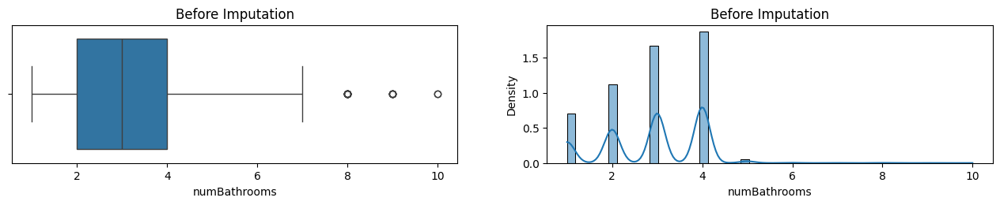

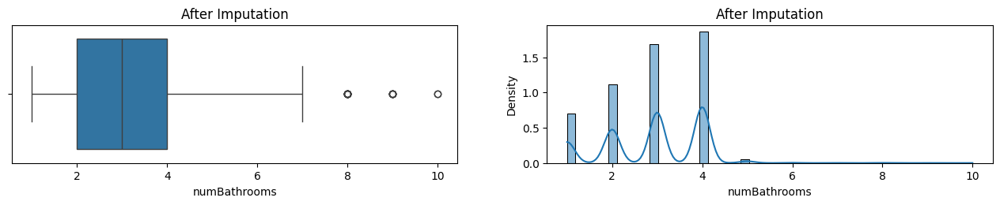

In [ ]:
# compare old and new box hist plot after imputation
def oldNewBoxHistPlot(df,df_new,feature, figsize=(16,5)):
    plt.figure(figsize=figsize)
    plt.subplot(221)
    sns.boxplot(x=feature, data=df)
    plt.title("Before Imputation")
    plt.subplot(222)
    sns.histplot(x=feature,data=df,stat="density", kde=True)
    plt.title("Before Imputation")
    plt.figure(figsize=figsize)
    plt.subplot(223)
    sns.boxplot(x=feature, data=df_new)
    plt.title("After Imputation")
    plt.subplot(224)
    sns.histplot(x=feature,data=df_new,stat="density", kde=True)
    plt.title("After Imputation")
    plt.show()

oldNewBoxHistPlot(df,df_mvi,"numBathrooms")

handling isNegotiable missing values

In [ ]:
print(df_mvi['isNegotiable'].value_counts(dropna=False))
print("\nPercentage of non-missing values:")
print(df_mvi['isNegotiable'].value_counts(normalize=True, dropna=False) * 100)

isNegotiable
NaN           9642
Negotiable     358
Name: count, dtype: int64

Percentage of non-missing values:
isNegotiable
NaN           96.42
Negotiable     3.58
Name: proportion, dtype: float64


In [ ]:
isnegotiable_cont = "NA"
df_mvi["isNegotiable"] = df_mvi["isNegotiable"].replace(np.nan, isnegotiable_cont)

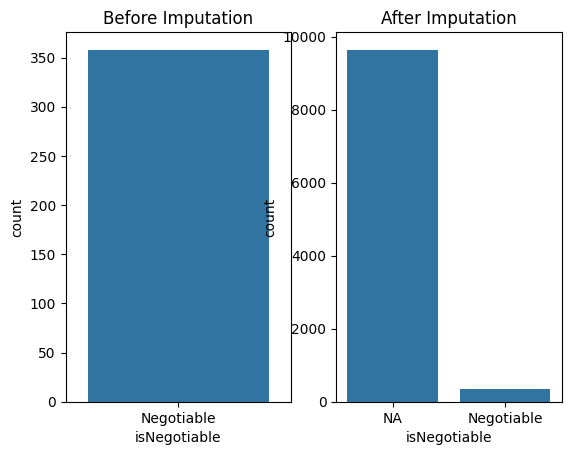

In [ ]:
plot_data(df, df_mvi, 'isNegotiable')

handling Description missing values

In [ ]:
print(df_mvi['description'].value_counts(dropna=False))
print("\nPercentage of non-missing values:")
print(df_mvi['isNegotiable'].value_counts(normalize=True, dropna=False) * 100)

description
NaN                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

In [ ]:
description_cont = "NA"
df_mvi["description"] = df_mvi["description"].replace(np.nan, description_cont)

/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128 (\x80) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 153 (\x99) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 147 (\x93) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


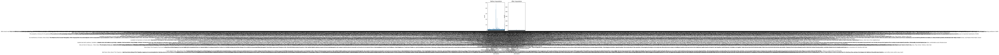

In [ ]:
plot_data(df, df_mvi, 'description')

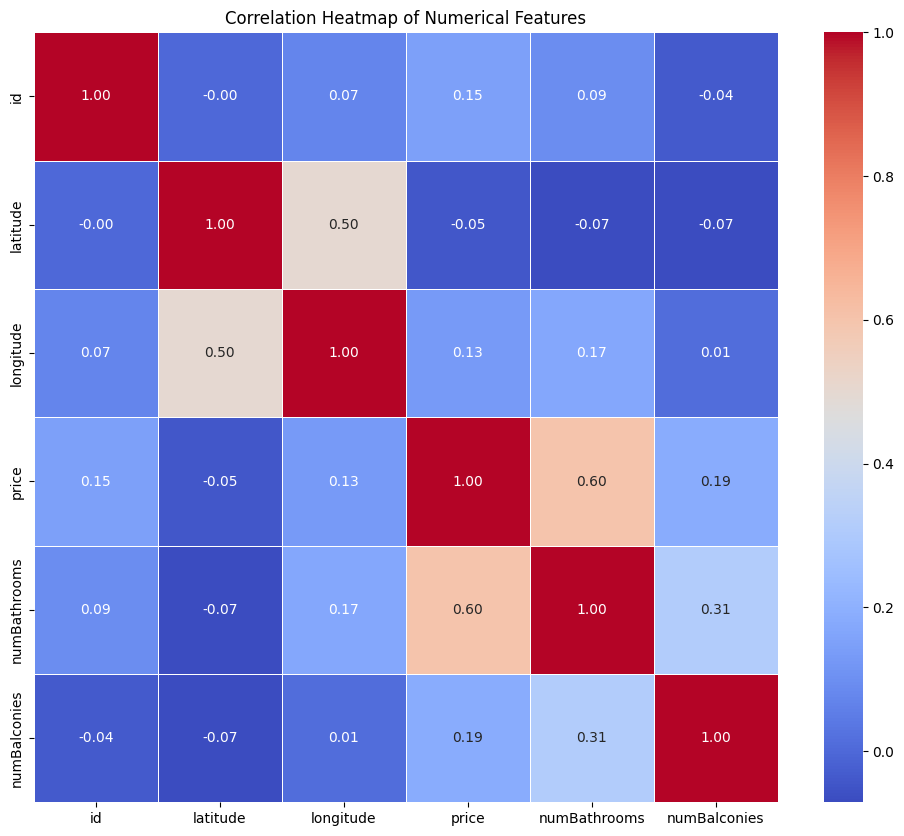

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Select only numeric columns for correlation
numeric_df = df_mvi.select_dtypes(include=['number'])

# Ensure 'house_size_numeric' and 'price' are included if they exist and are numeric
# (they should be from previous steps)

# Calculate the correlation matrix
correlation_matrix = numeric_df.corr()

plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation Heatmap of Numerical Features')
plt.show()

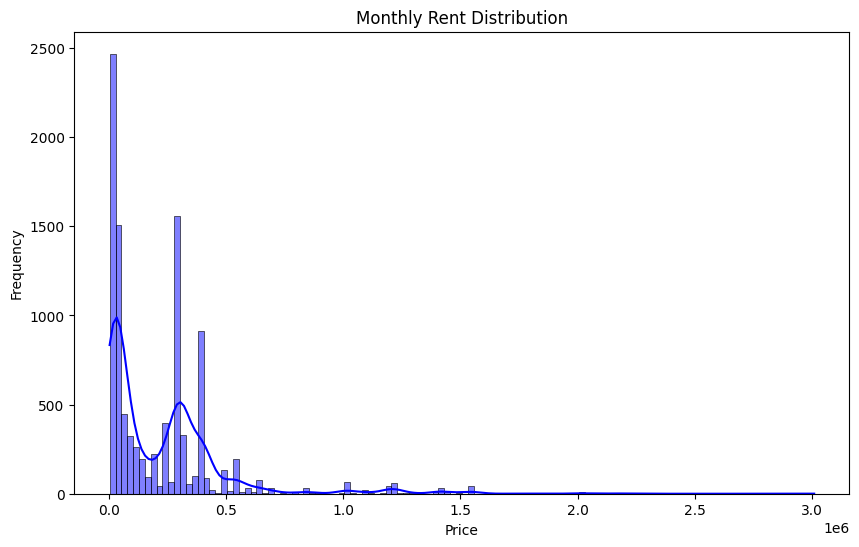

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.histplot(df_mvi['price'], kde=True, color='blue')
plt.title('Monthly Rent Distribution')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

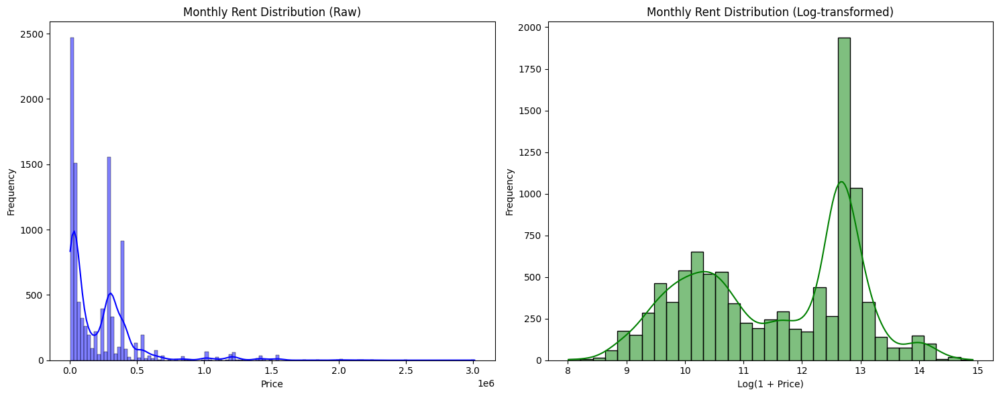

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

plt.figure(figsize=(15, 6))

# Subplot 1: Original Distribution
plt.subplot(1, 2, 1) # 1 row, 2 columns, first plot
sns.histplot(df_mvi['price'], kde=True, color='blue')
plt.title('Monthly Rent Distribution (Raw)')
plt.xlabel('Price')
plt.ylabel('Frequency')

# Subplot 2: Log-transformed Distribution
plt.subplot(1, 2, 2) # 1 row, 2 columns, second plot
sns.histplot(np.log1p(df_mvi['price']), kde=True, color='green')
plt.title('Monthly Rent Distribution (Log-transformed)')
plt.xlabel('Log(1 + Price)')
plt.ylabel('Frequency')

plt.tight_layout() # Adjust layout to prevent overlapping titles/labels
plt.show()

In [ ]:
print(df.columns)

Index(['id', 'house_type', 'house_size', 'location', 'city', 'latitude',
       'longitude', 'price', 'currency', 'numBathrooms', 'numBalconies',
       'isNegotiable', 'priceSqFt', 'verificationDate', 'description',
       'SecurityDeposit', 'Status'],
      dtype='object')


Numerical to categorical(ordinal object)

In [ ]:
for_num_con = ["house_size","verificationDate"]
for feat in for_num_con:
    print(f"{feat}: data type = {df_mvi[feat].dtype}")

house_size: data type = object
verificationDate: data type = object


Categorical into numerical

In [ ]:
df_mvi['house_size_sqft'] = df_mvi['house_size'].str.replace(' sq ft', '', regex=False).str.replace(',', '', regex=False).astype(float)
bins = [
    df_mvi['house_size_sqft'].min() - 1,
    500,
    1000,
    2000,
    df_mvi['house_size_sqft'].max() + 1
]
labels = ['Very Small (<500 sqft)', 'Small (500-1000 sqft)', 'Medium (1000-2000 sqft)', 'Large (>2000 sqft)']
df_mvi['house_size_category'] = pd.cut(
    df_mvi['house_size_sqft'],
    bins=bins,
    labels=labels,
    right=False,
    include_lowest=True
)

In [ ]:
print(df_mvi['house_size_category'].value_counts().sort_index())

house_size_category
Very Small (<500 sqft)      592
Small (500-1000 sqft)      1622
Medium (1000-2000 sqft)    2178
Large (>2000 sqft)         5608
Name: count, dtype: int64


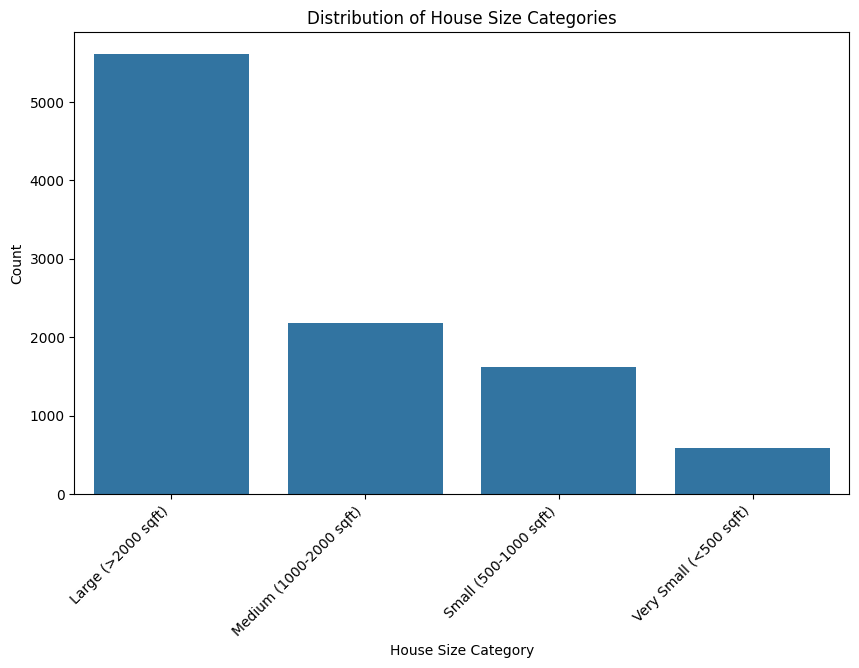

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(x='house_size_category', data=df_mvi, order=df_mvi['house_size_category'].value_counts().index)
plt.title('Distribution of House Size Categories')
plt.xlabel('House Size Category')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.show()

In [ ]:
df_mvi.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   id                   10000 non-null  int64   
 1   house_type           10000 non-null  object  
 2   house_size           10000 non-null  object  
 3   location             10000 non-null  object  
 4   city                 10000 non-null  object  
 5   latitude             10000 non-null  float64 
 6   longitude            10000 non-null  float64 
 7   price                10000 non-null  int64   
 8   currency             10000 non-null  object  
 9   numBathrooms         10000 non-null  float64 
 10  numBalconies         10000 non-null  float64 
 11  isNegotiable         10000 non-null  object  
 12  priceSqFt            10000 non-null  object  
 13  verificationDate     10000 non-null  object  
 14  description          10000 non-null  object  
 15  SecurityDeposit     

Categorial into Numerical(nominal objects)

In [ ]:

df_encod=df_mvi.copy()

object_features=df_encod.select_dtypes(include=["object", "category"]).columns.to_list()
print(object_features)

['house_type', 'house_size', 'location', 'city', 'currency', 'isNegotiable', 'priceSqFt', 'verificationDate', 'description', 'SecurityDeposit', 'Status', 'house_size_category']


In [ ]:
df_encod[object_features].head(2)


,house_type,house_size,location,city,currency,isNegotiable,priceSqFt,verificationDate,description,SecurityDeposit,Status,house_size_category
0,1 RK Studio Apartment,400 sq ft,Kalkaji,Delhi,INR,NA,NA,Posted a day ago,"Fully furnished, loaded with amenities & gadge...",No Deposit,Furnished,Very Small (<500 sqft)
1,1 RK Studio Apartment,400 sq ft,Mansarover Garden,Delhi,INR,NA,NA,Posted 9 days ago,Here is an excellent 1 BHK Independent Floor a...,No Deposit,Furnished,Very Small (<500 sqft)


In [ ]:

print("before",df_encod.shape)
df_encod=pd.get_dummies(df_encod,
                        columns=object_features,
                        prefix=object_features,
                        drop_first=True)
print("after",df_encod.shape)

before (10000, 19)
after (10000, 5181)


In [ ]:
df_encod.head(2)


,id,latitude,longitude,price,numBathrooms,numBalconies,house_size_sqft,house_type_1 BHK Independent Floor,house_type_1 BHK Independent House,house_type_1 RK Studio Apartment,house_type_10 BHK Independent House,house_type_12 BHK Independent House,house_type_2 BHK Apartment,house_type_2 BHK Independent Floor,house_type_2 BHK Independent House,house_type_3 BHK Apartment,house_type_3 BHK Independent Floor,house_type_3 BHK Independent House,house_type_4 BHK Apartment,house_type_4 BHK Independent Floor,house_type_4 BHK Independent House,house_type_4 BHK Villa,house_type_5 BHK Apartment,house_type_5 BHK Independent Floor,house_type_5 BHK Independent House,house_type_5 BHK Villa,house_type_6 BHK Independent Floor,house_type_6 BHK penthouse,house_type_7 BHK Independent Floor,house_type_7 BHK Independent House,house_type_8 BHK Independent Floor,house_type_8 BHK Independent House,house_type_8 BHK Villa,house_type_9 BHK Independent House,"house_size_1,010 sq ft","house_size_1,020 sq ft","house_size_1,050 sq ft","house_size_1,080 sq ft","house_size_1,090 sq ft","house_size_1,100 sq ft","house_size_1,110 sq ft","house_size_1,125 sq ft","house_size_1,130 sq ft","house_size_1,147 sq ft","house_size_1,150 sq ft","house_size_1,154 sq ft","house_size_1,162 sq ft","house_size_1,170 sq ft","house_size_1,180 sq ft","house_size_1,183 sq ft","house_size_1,200 sq ft","house_size_1,210 sq ft","house_size_1,220 sq ft","house_size_1,225 sq ft","house_size_1,230 sq ft","house_size_1,240 sq ft","house_size_1,250 sq ft","house_size_1,270 sq ft","house_size_1,275 sq ft","house_size_1,300 sq ft","house_size_1,310 sq ft","house_size_1,350 sq ft","house_size_1,375 sq ft","house_size_1,380 sq ft","house_size_1,400 sq ft","house_size_1,410 sq ft","house_size_1,420 sq ft","house_size_1,422 sq ft","house_size_1,440 sq ft","house_size_1,450 sq ft","house_size_1,460 sq ft","house_size_1,485 sq ft","house_size_1,500 sq ft","house_size_1,503 sq ft","house_size_1,510 sq ft","house_size_1,514 sq ft","house_size_1,525 sq ft","house_size_1,530 sq ft","house_size_1,548 sq ft","house_size_1,550 sq ft","house_size_1,600 sq ft","house_size_1,625 sq ft","house_size_1,639 sq ft","house_size_1,650 sq ft","house_size_1,670 sq ft","house_size_1,680 sq ft","house_size_1,700 sq ft","house_size_1,710 sq ft","house_size_1,740 sq ft","house_size_1,750 sq ft","house_size_1,753 sq ft","house_size_1,780 sq ft","house_size_1,790 sq ft","house_size_1,800 sq ft","house_size_1,801 sq ft","house_size_1,820 sq ft","house_size_1,846 sq ft","house_size_1,850 sq ft","house_size_1,851 sq ft","house_size_1,855 sq ft","house_size_1,856 sq ft","house_size_1,870 sq ft","house_size_1,872 sq ft","house_size_1,890 sq ft","house_size_1,900 sq ft","house_size_1,950 sq ft","house_size_1,953 sq ft","house_size_1,955 sq ft","house_size_1,960 sq ft","house_size_1,973 sq ft","house_size_1,980 sq ft","house_size_10,000 sq ft","house_size_11,221 sq ft","house_size_14,521 sq ft",house_size_150 sq ft,house_size_180 sq ft,"house_size_2,000 sq ft","house_size_2,025 sq ft","house_size_2,041 sq ft","house_size_2,050 sq ft","house_size_2,054 sq ft","house_size_2,080 sq ft","house_size_2,097 sq ft","house_size_2,100 sq ft","house_size_2,120 sq ft","house_size_2,150 sq ft","house_size_2,160 sq ft","house_size_2,200 sq ft","house_size_2,250 sq ft","house_size_2,253 sq ft","house_size_2,300 sq ft","house_size_2,350 sq ft","house_size_2,351 sq ft","house_size_2,352 sq ft","house_size_2,365 sq ft","house_size_2,385 sq ft","house_size_2,390 sq ft","house_size_2,400 sq ft","house_size_2,430 sq ft","house_size_2,450 sq ft","house_size_2,500 sq ft","house_size_2,511 sq ft","house_size_2,541 sq ft","house_size_2,550 sq ft","house_size_2,562 sq ft","house_size_2,600 sq ft","house_size_2,700 sq ft","house_size_2,725 sq ft","house_size_2,741 sq ft","house_size_2,745 sq ft","house_size_2,750 sq ft","house_size_2,771 sq ft","house_size_2,800 sq ft","house_size_2,846 sq ft","house_size_2,851 sq ft","house_size_2,852 sq ft","house_size_2,8

Split Data

In [ ]:
len_train=df_train.shape[0]
len_train

5000

In [ ]:
len_train=df_train.shape[0]
len_train
X_train=df_encod[:len_train].drop("price",axis=1)
y_train=df_encod[:len_train]["price"]
X_test=df_encod[len_train:].drop("price",axis=1)


print("Shape of X_train",X_train.shape)
print("Shape of y_train",y_train.shape)
print("Shape of X_test",X_test.shape)

Shape of X_train (5000, 5180)
Shape of y_train (5000,)
Shape of X_test (5000, 5180)


In [ ]:
sc = StandardScaler()

sc.fit(X_train)
X_train=sc.transform(X_train)
X_test=sc.transform(X_test)

Cross Validation and Model Selection


In [ ]:
from sklearn.linear_model import LinearRegression
from xgboost import XGBRegressor
from sklearn.ensemble import RandomForestRegressor


In [ ]:
lr = LinearRegression()
xgbr = XGBRegressor()
rf = RandomForestRegressor(random_state=42)


In [ ]:
import pandas as pd

# Train RandomForest model
rf.fit(X_train, y_train)
rf_train_preds = rf.predict(X_train)
rf_test_preds = rf.predict(X_test)

# Train XGBoost model
xgbr.fit(X_train, y_train)
xgbr_train_preds = xgbr.predict(X_train)
xgbr_test_preds = xgbr.predict(X_test)

# Create new training and testing datasets for the meta-model
X_meta_train = pd.DataFrame({'RandomForest': rf_train_preds, 'XGBoost': xgbr_train_preds})
X_meta_test = pd.DataFrame({'RandomForest': rf_test_preds, 'XGBoost': xgbr_test_preds})

print("Shape of X_meta_train:", X_meta_train.shape)
print("Shape of X_meta_test:", X_meta_test.shape)

Shape of X_meta_train: (5000, 2)
Shape of X_meta_test: (5000, 2)


In [ ]:
lr.fit(X_meta_train, y_train)
print("Meta-model (Linear Regression) trained.")

Meta-model (Linear Regression) trained.


In [ ]:
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Generate final predictions using the meta-model
hybrid_predictions = lr.predict(X_meta_test)
print("Hybrid ensemble predictions generated.")

# Assuming y_test corresponds to the 'price' column for the test set portion of df_encod
y_test = df_encod[len_train:]["price"]

# Evaluate the hybrid model
mae = mean_absolute_error(y_test, hybrid_predictions)
mse = mean_squared_error(y_test, hybrid_predictions)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, hybrid_predictions)

print(f"\nHybrid Model Mean Absolute Error (MAE): {mae:.2f}")
print(f"Hybrid Model Mean Squared Error (MSE): {mse:.2f}")
print(f"Hybrid Model Root Mean Squared Error (RMSE): {rmse:.2f}")
print(f"Hybrid Model R-squared (R2): {r2:.2f}")


# Evaluate the Random Forest
rf_mae = mean_absolute_error(y_test, rf_test_preds)
rf_mse = mean_squared_error(y_test, rf_test_preds)
rf_rmse = np.sqrt(mse)
rf_r2 = r2_score(y_test, rf_test_preds)

print(f"\nRandomForest Mean Absolute Error (MAE): {rf_mae:.2f}")
print(f"RandomForest Mean Squared Error (MSE): {rf_mse:.2f}")
print(f"RandomForest Root Mean Squared Error (RMSE): {rf_rmse:.2f}")
print(f"RandomForest R-squared (R2): {rf_r2:.2f}")


# Evaluate the XGboost
xgbr_mae = mean_absolute_error(y_test, xgbr_test_preds)
xgbr_mse = mean_squared_error(y_test, xgbr_test_preds)
xgbr_rmse = np.sqrt(mse)
xgbr_r2 = r2_score(y_test, xgbr_test_preds)

print(f"\nXGboost Mean Absolute Error (MAE): {xgbr_mae:.2f}")
print(f"XGboost Mean Squared Error (MSE): {xgbr_mse:.2f}")
print(f"XGboost Root Mean Squared Error (RMSE): {xgbr_rmse:.2f}")
print(f"XGboost R-squared (R2): {xgbr_r2:.2f}")


Hybrid ensemble predictions generated.

Hybrid Model Mean Absolute Error (MAE): 29099.81
Hybrid Model Mean Squared Error (MSE): 2902859646.28
Hybrid Model Root Mean Squared Error (RMSE): 53878.19
Hybrid Model R-squared (R2): 0.96

RandomForest Mean Absolute Error (MAE): 27637.33
RandomForest Mean Squared Error (MSE): 2749911538.14
RandomForest Root Mean Squared Error (RMSE): 53878.19
RandomForest R-squared (R2): 0.96

XGboost Mean Absolute Error (MAE): 27378.10
XGboost Mean Squared Error (MSE): 1970707968.00
XGboost Root Mean Squared Error (RMSE): 53878.19
XGboost R-squared (R2): 0.97


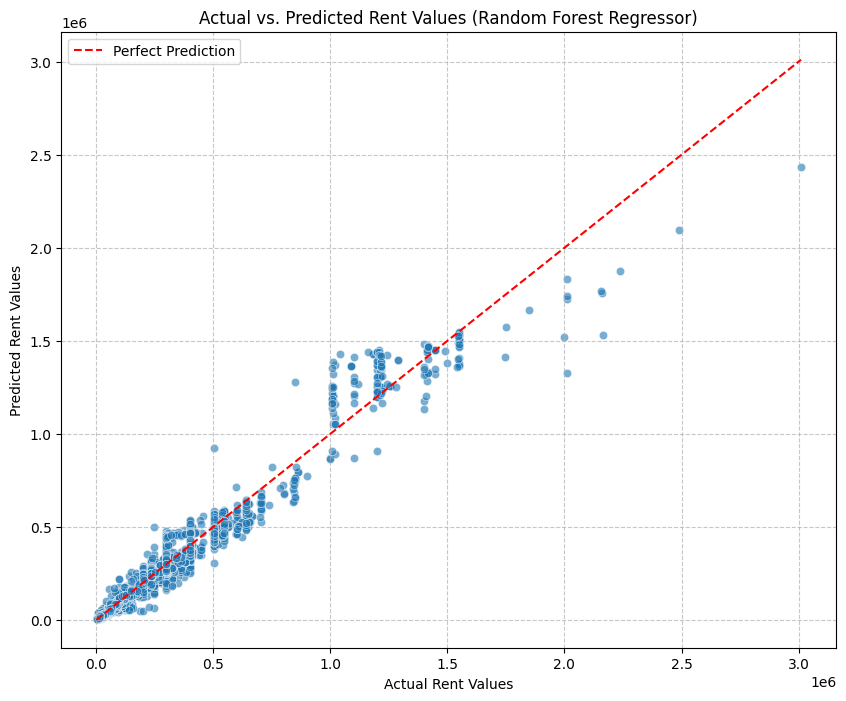

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 8))
sns.scatterplot(x=y_test, y=rf_test_preds, alpha=0.6)
plt.title('Actual vs. Predicted Rent Values (Random Forest Regressor)')
plt.xlabel('Actual Rent Values')
plt.ylabel('Predicted Rent Values')

# Add a diagonal line for perfect predictions
min_val = min(y_test.min(), rf_test_preds.min())
max_val = max(y_test.max(), rf_test_preds.max())
plt.plot([min_val, max_val], [min_val, max_val], color='red', linestyle='--', label='Perfect Prediction')

plt.grid(True, linestyle='--', alpha=0.7)
plt.legend()
plt.show()

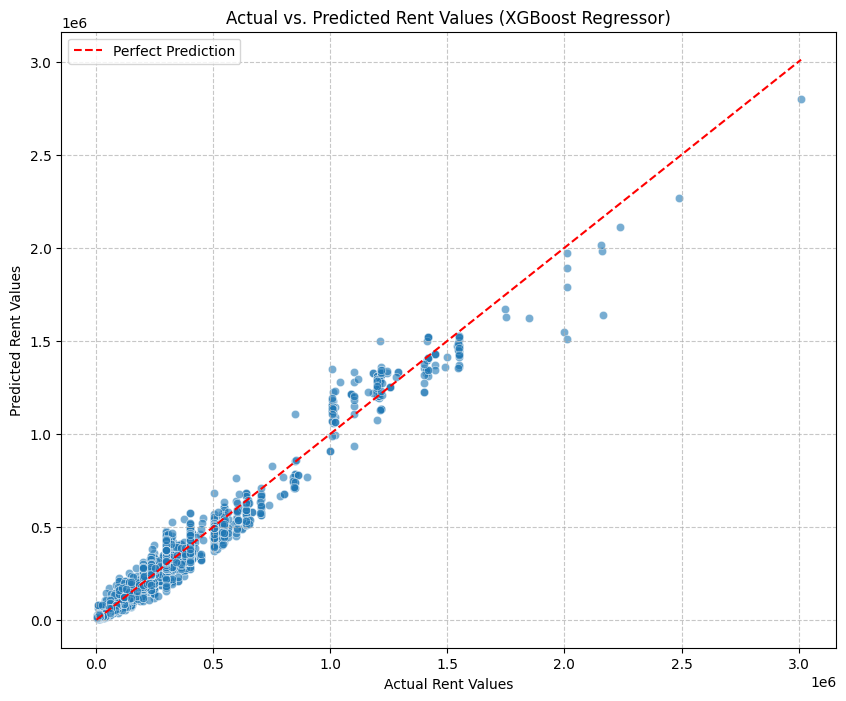

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 8))
sns.scatterplot(x=y_test, y=xgbr_test_preds, alpha=0.6)
plt.title('Actual vs. Predicted Rent Values (XGBoost Regressor)')
plt.xlabel('Actual Rent Values')
plt.ylabel('Predicted Rent Values')

# Add a diagonal line for perfect predictions
min_val = min(y_test.min(), xgbr_test_preds.min())
max_val = max(y_test.max(), xgbr_test_preds.max())
plt.plot([min_val, max_val], [min_val, max_val], color='red', linestyle='--', label='Perfect Prediction')

plt.grid(True, linestyle='--', alpha=0.7)
plt.legend()
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Ensure hybrid_predictions_new and y_test are available
if 'hybrid_predictions_new' in locals() and 'y_test' in locals():
    plt.figure(figsize=(10, 8))
    sns.scatterplot(x=y_test, y=hybrid_predictions_new, alpha=0.6)
    plt.title('Actual vs. Predicted Rent Values (Hybrid Model)')
    plt.xlabel('Actual Rent Values ($)')
    plt.ylabel('Predicted Rent Values ($)')

    # Add a diagonal line for perfect predictions
    min_val = min(y_test.min(), hybrid_predictions_new.min())
    max_val = max(y_test.max(), hybrid_predictions_new.max())
    plt.plot([min_val, max_val], [min_val, max_val], color='red', linestyle='--', label='Perfect Prediction')

    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend()
    plt.show()
else:
    print("Error: Hybrid model predictions or actual test values are not available. Please ensure the model evaluation steps were run.")

Error: Hybrid model predictions or actual test values are not available. Please ensure the model evaluation steps were run.


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Ensure hybrid_predictions_new and y_test are available
if 'hybrid_predictions_new' in locals() and 'y_test' in locals():
    # Calculate residuals
    residuals = y_test - hybrid_predictions_new

    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=hybrid_predictions_new, y=residuals, alpha=0.6)
    plt.axhline(y=0, color='red', linestyle='--', linewidth=2)
    plt.title('Residual Analysis: Predicted Residuals vs. Fitted Values (Hybrid Model)')
    plt.xlabel('Fitted Values (Predicted Rent)')
    plt.ylabel('Residuals (Actual - Predicted)')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.show()
else:
    print("Error: Hybrid model predictions or actual test values are not available. Please ensure the model evaluation steps were run.")

Error: Hybrid model predictions or actual test values are not available. Please ensure the model evaluation steps were run.


In [ ]:
from sklearn.model_selection import KFold, cross_val_score

def test_model(model, X_train, y_train):
    cv = KFold(n_splits=3, shuffle=True, random_state=42)
    score = cross_val_score(model, X_train, y_train, cv=cv, scoring='r2')
    return score.mean()

In [ ]:
models = {
    '0': ['Linear Regression', lr],
    '1': ['XGBoost Regressor', xgbr],
    '2': ['RandomForest Regressor', rf]
}

models_score = []
for model_key in models:
    model_name = models[model_key][0]
    model_instance = models[model_key][1]
    print(f"Model Name: {model_name}")
    score = test_model(model_instance, X_train, y_train)
    print(f"Score of Model: {score:.4f}")
    print("-----------------------")
    models_score.append([model_name, score])

Model Name: Linear Regression
Score of Model: 0.7039
-----------------------
Model Name: XGBoost Regressor
Score of Model: 0.9156
-----------------------
Model Name: RandomForest Regressor
Score of Model: 0.9149
-----------------------


Model Training

In [ ]:
lr.fit(X_train , y_train)

LinearRegression()

In [ ]:
y_pred_df = pd.DataFrame(hybrid_predictions, columns=['RentPrice'])
y_pred_with_id = pd.concat([df_encod['id'][len_train:].reset_index(drop=True), y_pred_df], axis=1)
y_pred_with_id

,id,RentPrice
0,5001,1.410480e+04
1,5002,1.513474e+04
2,5003,4.131308e+03
3,5004,3.190296e+04
4,5005,1.632797e+04
5,5006,9.198228e+03
6,5007,1.741436e+04
7,5008,2.224546e+04
8,5009,2.422135e+04
9,5010,7.506079e+04


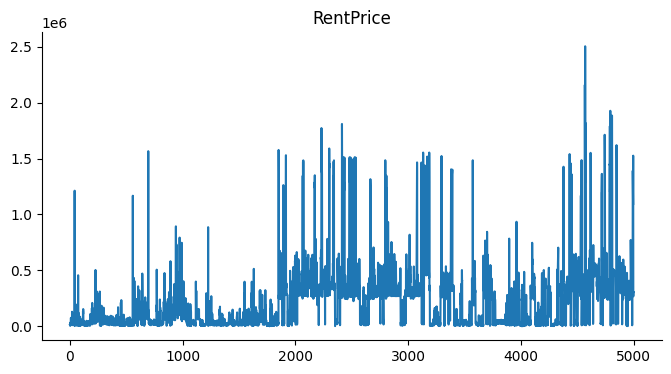

In [ ]:
from matplotlib import pyplot as plt
y_pred_with_id['RentPrice'].plot(kind='line', figsize=(8, 4), title='RentPrice')
plt.gca().spines[['top', 'right']].set_visible(False)

In [ ]:
# Save the predictions to a CSV file
y_pred_with_id.to_csv('hybrid_model_predictions.csv', index=False)
print("Predictions saved to 'hybrid_model_predictions.csv'")

Predictions saved to 'hybrid_model_predictions.csv'


In [ ]:
# Display the first few rows of the saved CSV to confirm
import pandas as pd
saved_predictions = pd.read_csv('hybrid_model_predictions.csv')
display(saved_predictions.head())

,id,RentPrice
0,5001,14104.800860
1,5002,15134.742185
2,5003,4131.308228
3,5004,31902.963310
4,5005,16327.965324


In [ ]:
import pandas as pd

# Calculate mean rent for each location and get the top 5
top_5_localities = df_mvi.groupby('location')['price'].mean().nlargest(5)

print("Top 5 Localities by Mean Rent:")
display(top_5_localities)

Top 5 Localities by Mean Rent:


,price
location,
Central Ridge Reserve Forest,2.000000e+06
Kasturba Gandhi Marg,1.481532e+06
Aurungzeb Road,1.431967e+06
Amrita Shergill Marg,1.399905e+06
Lodhi Road,1.375466e+06


In [ ]:
import joblib

# Save the trained meta-model (Linear Regression) to a file
joblib.dump(lr, 'stacked_model.joblib')

print("Trained meta-model saved to 'stacked_model.joblib'")

Trained meta-model saved to 'stacked_model.joblib'


Time Series


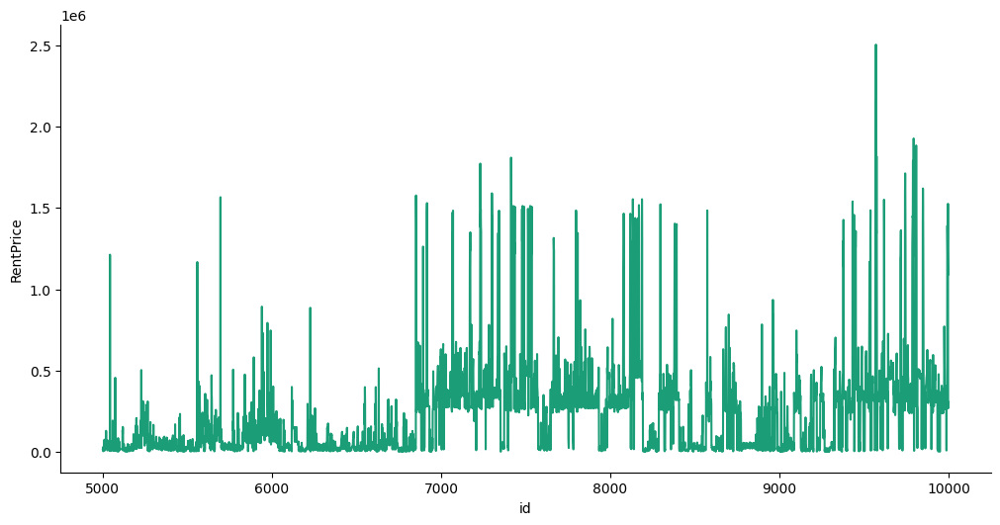

In [ ]:
from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['id']
  ys = series['RentPrice']

  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = y_pred_with_id.sort_values('id', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('id')
_ = plt.ylabel('RentPrice')

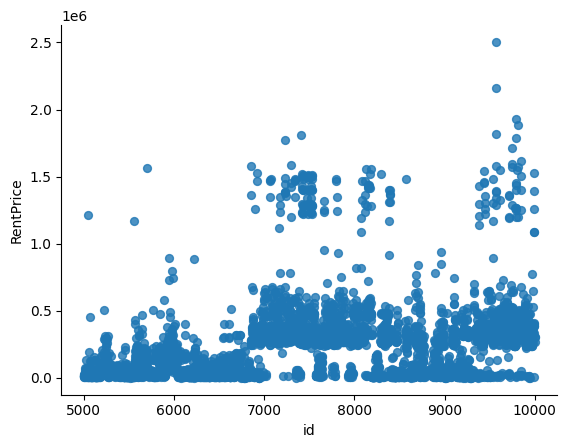

In [ ]:
from matplotlib import pyplot as plt
y_pred_with_id.plot(kind='scatter', x='id', y='RentPrice', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

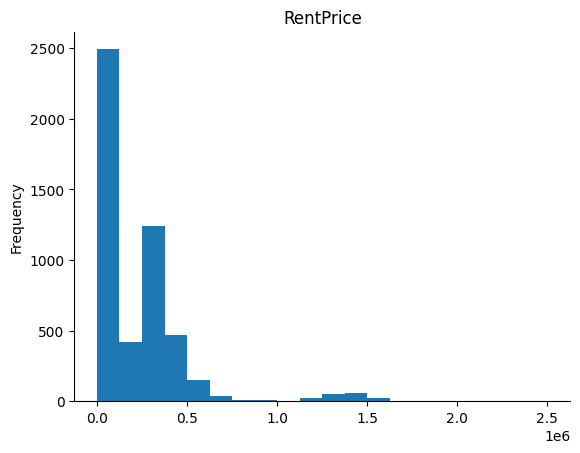

In [ ]:
from matplotlib import pyplot as plt
y_pred_with_id['RentPrice'].plot(kind='hist', bins=20, title='RentPrice')
plt.gca().spines[['top', 'right',]].set_visible(False)

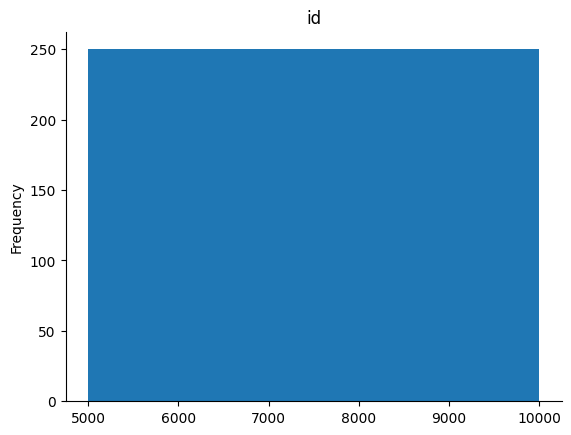

In [ ]:
from matplotlib import pyplot as plt
y_pred_with_id['id'].plot(kind='hist', bins=20, title='id')
plt.gca().spines[['top', 'right',]].set_visible(False)